## NeurIPS heads replication (HCP spin)

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

  import numpy.matlib as npm

  autumn = cm.get_cmap('autumn', 256)

  winter = cm.get_cmap('winter_r', 256)



In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run) 

<module 'sim.sim_run' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/sim/sim_run.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 6.4%
RAM Usage: 3.1%
Available RAM: 1.4T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

### Attention heads

In [7]:
from models.smt import SharedSelfAttentionModel, SharedSelfAttentionCLSModel

from data.data_load import load_transcriptome, load_connectome, load_coords, load_network_labels
from data.data_viz import plot_connectome, plot_transcriptome
from data.data_utils import expand_X_symmetric, expand_Y_symmetric

from data.data_utils import RegionPairDataset
from torch.utils.data import Subset

In [8]:
# Load data
print("Loading data...")
X, valid_genes = load_transcriptome(parcellation='S456', hemisphere='both', omit_subcortical=False, sort_genes='refgenome', impute_strategy='mirror_interpolate', return_valid_genes=True)
Y = load_connectome(dataset='UKBB', parcellation='S456', hemisphere='both', omit_subcortical=False)
coords = load_coords(parcellation='S456', hemisphere='both', omit_subcortical=False)
labels, network_labels = load_network_labels(parcellation='S456', hemisphere='both', omit_subcortical=False)

# Find rows that are not all NaN - necessary for gene expression data with unsampled regions
valid_indices = ~np.isnan(X).all(axis=1)

# Create index map so we know true indices of valid data
valid_indices_values = np.where(valid_indices)[0]
valid2true_mapping = dict(enumerate(valid_indices_values))

# Subset all data using valid indices
X_valid = X[valid_indices]
Y_valid = Y[valid_indices][:, valid_indices]
coords_valid = coords[valid_indices]
labels = [labels[i] for i in range(len(labels)) if valid_indices[i]]
network_labels = network_labels[valid_indices]

Loading data...


Build network dataloaders

In [9]:
# Create pairwise datasets for each subnetwork
unique_networks = np.unique(network_labels)

network_datasets = {}
network_dataloaders = {}
print("Creating pairwise datasets and dataloaders for each subnetwork...")

for network in unique_networks:
    # Create mask for current network
    network_mask = network_labels == network
    
    # Subset data for this network
    X_network = X_valid[network_mask]
    Y_network = Y_valid[network_mask][:, network_mask]
    coords_network = coords_valid[network_mask]
    
    # Create mapping from network indices to true indices
    network_indices = np.where(network_mask)[0]
    network2true_mapping = {i: valid2true_mapping[idx] for i, idx in enumerate(network_indices)}
    
    # Create pairwise dataset for this network
    network_datasets[network] = RegionPairDataset(
        X=X_network,
        Y=Y_network,
        coords=coords_network,
        valid2true_mapping=network2true_mapping,
        dataset='UKBB',
        parcellation='S456', 
        valid_genes=valid_genes
    )
    
    # Create dataloader for this network
    network_dataloaders[network] = DataLoader(
        network_datasets[network],
        batch_size=512,
        shuffle=False,
        num_workers=4,
        pin_memory=True
    )
    print(f"Network {network}: {len(network_datasets[network])} region pairs")

Creating pairwise datasets and dataloaders for each subnetwork...
Network Cerebellum: 72 region pairs
Network Cont: 2652 region pairs
Network Default: 8190 region pairs
Network DorsAttn: 2070 region pairs
Network Limbic: 650 region pairs
Network SalVentAttn: 2162 region pairs
Network SomMot: 5852 region pairs
Network Subcortical: 2070 region pairs
Network Vis: 3660 region pairs


Build full dataset

In [10]:
# Create full pairwise dataset
print("Creating full pairwise dataset...")

# Create full pairwise dataset
full_dataset = RegionPairDataset(
    X=X_valid,
    Y=Y_valid, 
    coords=coords_valid,
    valid2true_mapping=valid2true_mapping,
    dataset='UKBB',
    parcellation='S456', 
    valid_genes=valid_genes
)

print(f"Full dataset: {len(full_dataset)} region pairs")

# Create full dataloader
full_dataloader = DataLoader(
    full_dataset,
    batch_size=512,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)


Creating full pairwise dataset...
Full dataset: 206570 region pairs


Load in models trained on full UKBB dataset

In [12]:
from models.smt import SharedSelfAttentionModel, SharedSelfAttentionCLSModel

# SMT EMBEDDINGS - 3 versions ###
smt_model_v1 = SharedSelfAttentionModel(input_dim=14760, token_encoder_dim=60, d_model=128,
                                          nhead=4, num_layers=4,
                                          deep_hidden_dims=[512, 256, 128], use_alibi=True, transformer_dropout=0.2,
                                          dropout_rate=0.2, learning_rate=0.00009, weight_decay=0.0001,
                                          batch_size=1024, aug_prob=0.3, epochs=110, num_workers=2, prefetch_factor=4)

smt_model_v2 = SharedSelfAttentionModel(input_dim=14760, token_encoder_dim=60, d_model=128,
                                          nhead=4, num_layers=4,
                                          deep_hidden_dims=[512, 256, 128], use_alibi=True, transformer_dropout=0.2,
                                          dropout_rate=0.2, learning_rate=0.00009, weight_decay=0.0001,
                                          batch_size=1024, aug_prob=0.3, epochs=110, num_workers=2, prefetch_factor=4)

# Load weights and prepare models
for i, model in enumerate([smt_model_v1, smt_model_v2], 1):
    model_path = f"/scratch/asr655/neuroinformatics/GeneEx2Conn/models/saved_models/HCP_smt_full{i}_spin.pt"
    model.load_state_dict(torch.load(model_path))
    model.eval()
    model.to("cuda")
    model.encoder.eval()

Number of learnable parameters in SMT model: 2162315
Number of learnable parameters in SMT model: 2162315


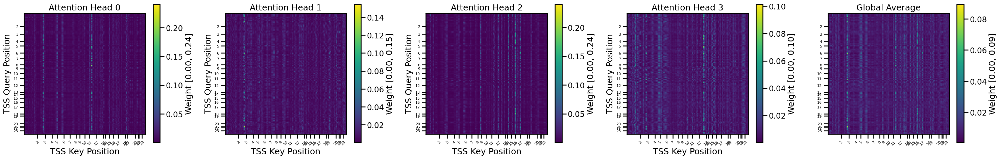

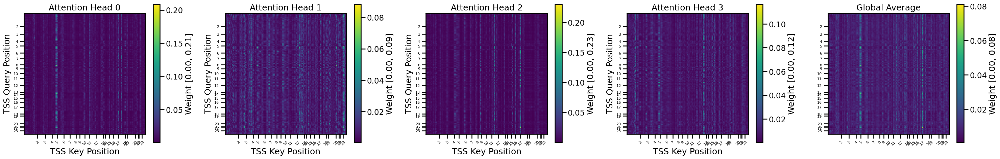

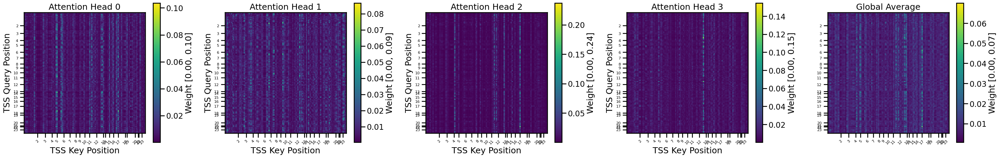

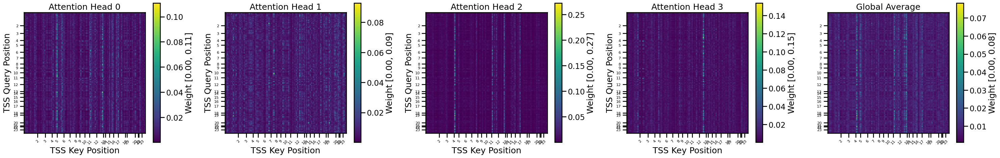

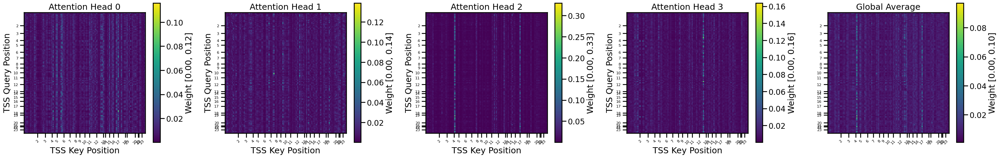

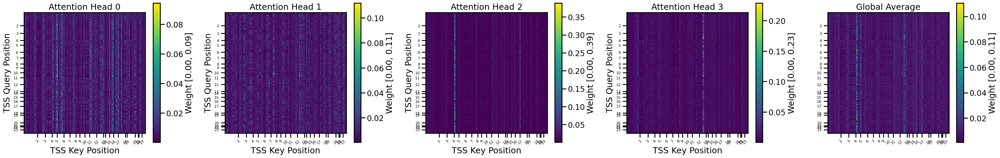

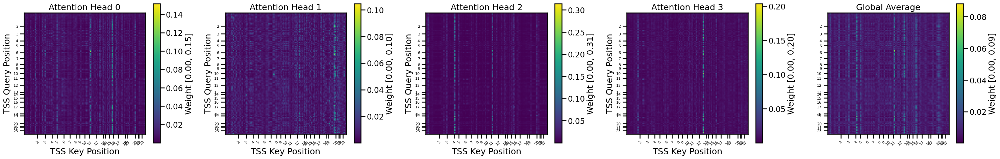

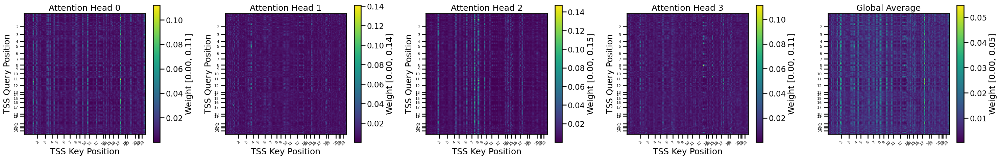

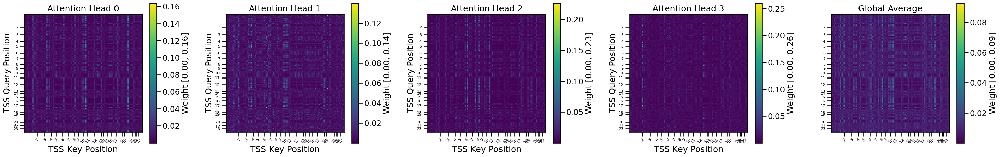

W1006 21:37:04.197000 22672670664512 torch/_dynamo/convert_frame.py:762] [1/8] torch._dynamo hit config.cache_size_limit (8)
W1006 21:37:04.197000 22672670664512 torch/_dynamo/convert_frame.py:762] [1/8]    function: 'forward' (/scratch/asr655/neuroinformatics/GeneEx2Conn/models/smt_utils.py:118)
W1006 21:37:04.197000 22672670664512 torch/_dynamo/convert_frame.py:762] [1/8]    last reason: ___check_obj_id(L['self'].ffn, 22665070785552)              
W1006 21:37:04.197000 22672670664512 torch/_dynamo/convert_frame.py:762] [1/8] To log all recompilation reasons, use TORCH_LOGS="recompiles".
W1006 21:37:04.197000 22672670664512 torch/_dynamo/convert_frame.py:762] [1/8] To diagnose recompilation issues, see https://pytorch.org/docs/main/torch.compiler_troubleshooting.html.


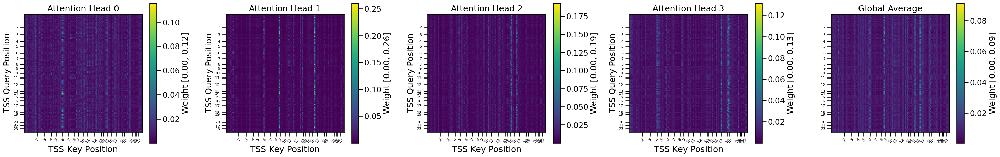

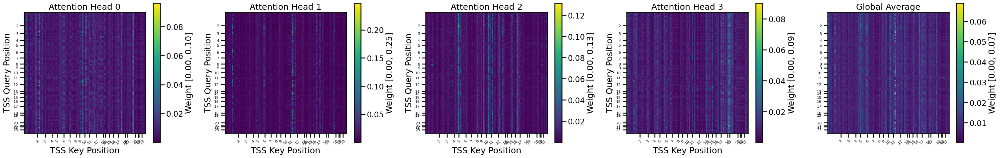

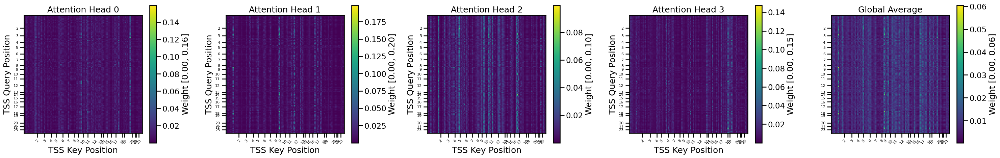

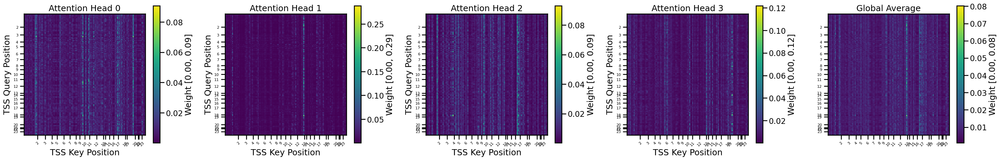

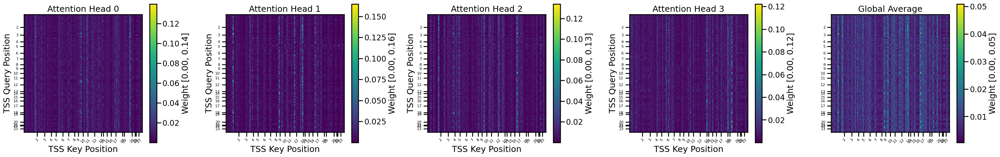

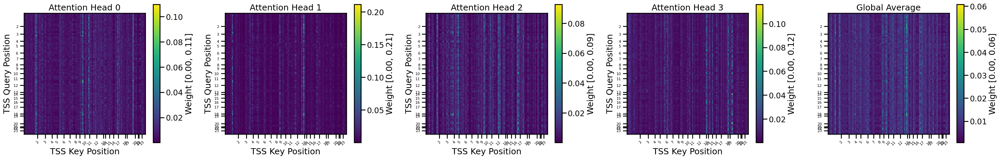

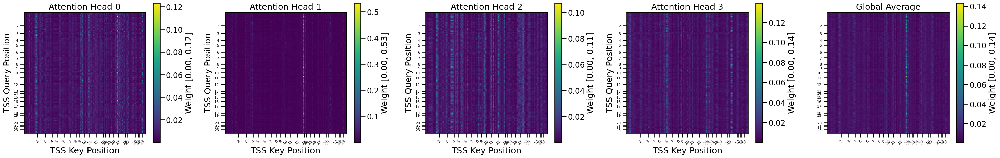

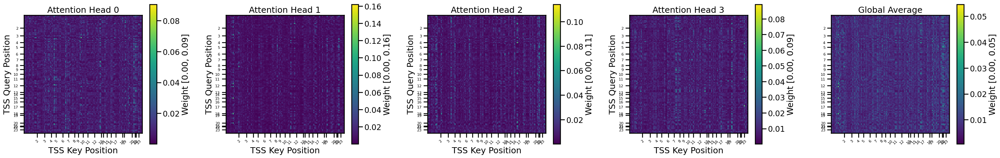

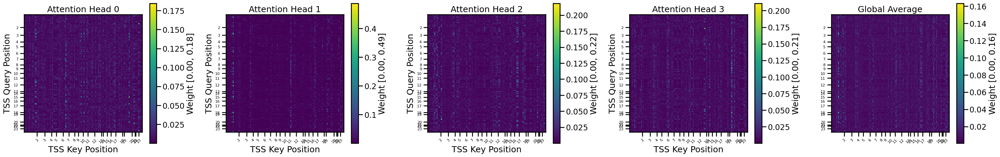

In [13]:
# Get predictions and attention weights for all base SMT models across all subnetworks
avg_attn_smt_dict_v1 = {}
avg_attn_smt_dict_v2 = {}
keys = ['Vis', 'SomMot', 'DorsAttn', 'SalVentAttn', 'Cont', 'Default', 'Limbic', 'Subcortical', 'Cerebellum']

# Collect for model v1
for subnetwork in keys:
    print(f"Collecting attention weights for base SMT model v1 on {subnetwork} system data...")
    predictions_v1, targets_v1, avg_attn = smt_model_v1.predict(
        network_dataloaders[subnetwork],
        collect_attn=True,
        #save_attn_path=f'smt_v1_{subnetwork}_avg_attn.npy'
    )
    avg_attn_smt_dict_v1[subnetwork] = avg_attn

# Collect for model v2  
for subnetwork in keys:
    print(f"Collecting attention weights for base SMT model v2 on {subnetwork} system data...")
    predictions_v2, targets_v2, avg_attn = smt_model_v2.predict(
        network_dataloaders[subnetwork],
        collect_attn=True,
        #save_attn_path=f'smt_v2_{subnetwork}_avg_attn.npy'
    )
    avg_attn_smt_dict_v2[subnetwork] = avg_attn

In [14]:
from models.smt_utils import plot_global_head_attention, plot_subnetwork_token_attention, plot_subnetwork_expression_correlation

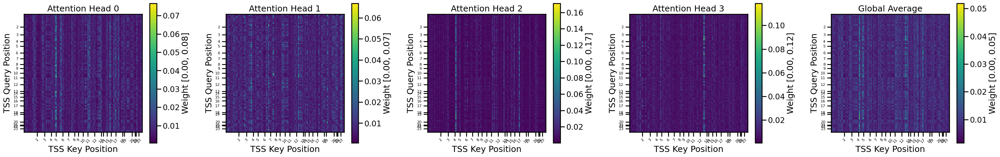

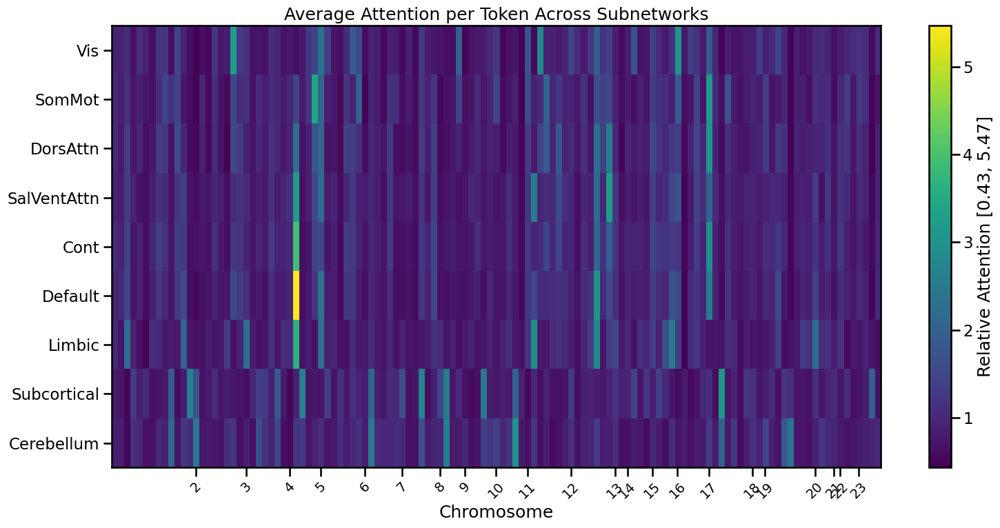

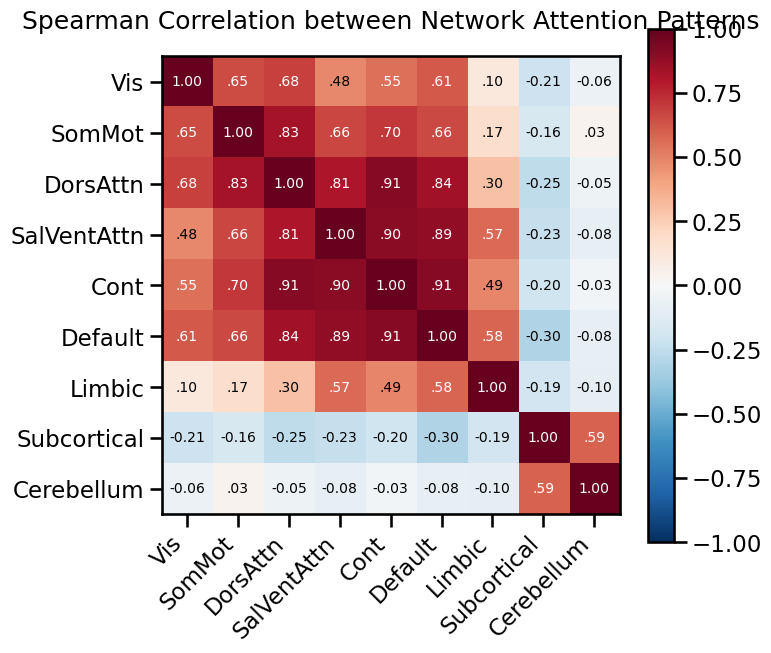

array([[0.92283952, 0.89852405, 1.04242253, ..., 1.07921028, 0.57478368,
        1.05083108],
       [0.96891642, 0.80778271, 1.10588002, ..., 1.08910108, 0.51368129,
        0.68896484],
       [1.01906645, 0.79973948, 1.30194449, ..., 0.89649141, 0.46399578,
        0.91658705],
       ...,
       [0.98209512, 0.71218121, 2.19804001, ..., 0.90934235, 0.74083656,
        0.64373291],
       [0.76749414, 0.69761753, 0.50995511, ..., 0.81264853, 1.97346377,
        0.68133283],
       [0.80502337, 0.81728208, 0.50166434, ..., 0.87911421, 0.92708582,
        0.98259318]])

In [15]:
plot_global_head_attention(avg_attn_smt_dict_v1, use_chrom_labels=True, token_encoder_dim=60)
plot_subnetwork_token_attention(avg_attn_smt_dict_v1, use_chrom_labels=True, token_encoder_dim=60)

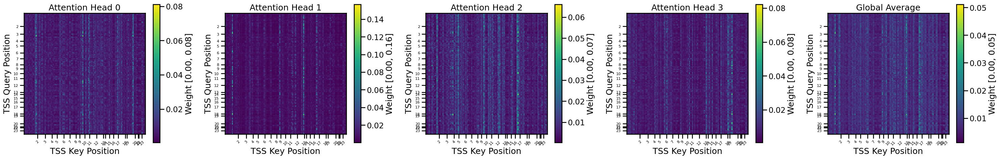

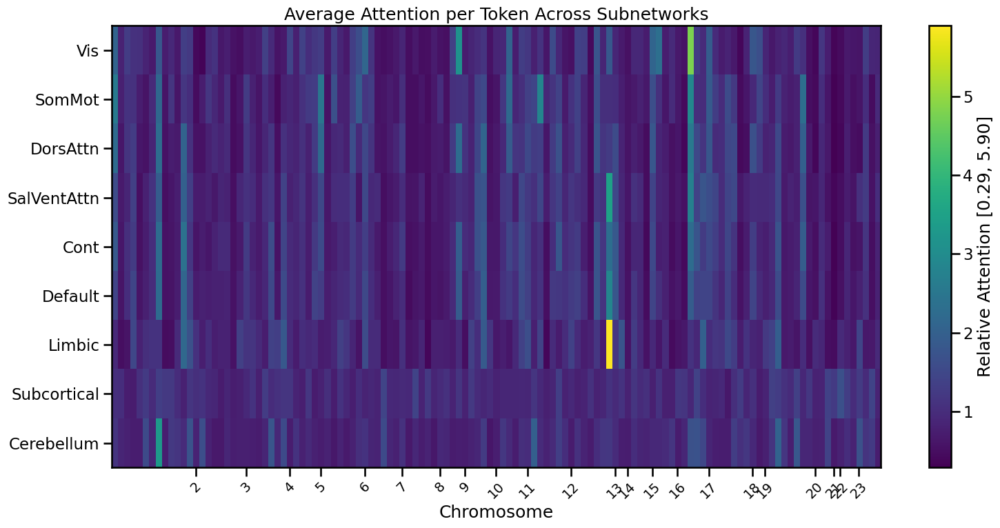

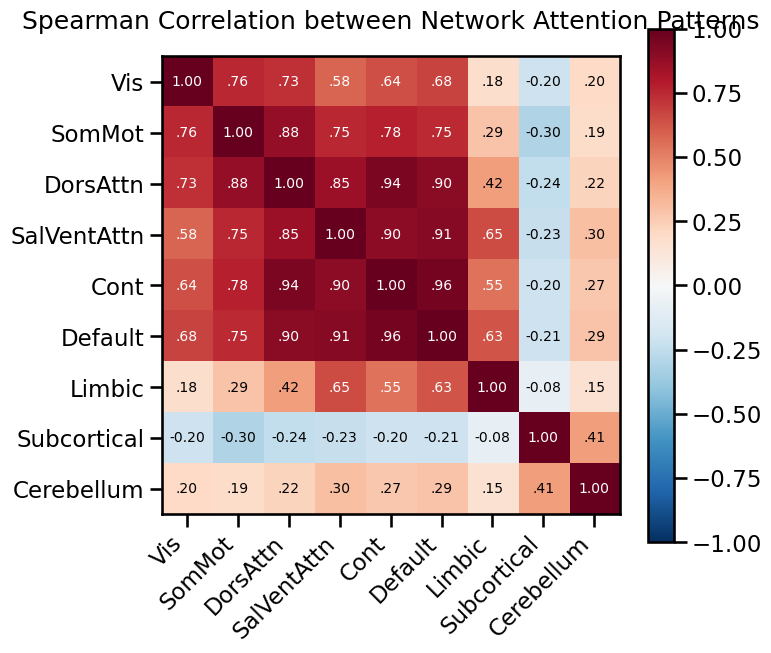

array([[2.06399536, 0.81426287, 1.28985691, ..., 1.31487811, 0.88413048,
        0.86813354],
       [2.57594299, 0.78939795, 1.11094272, ..., 1.02962255, 0.46803141,
        0.94503438],
       [2.24922109, 0.62856311, 1.13024044, ..., 1.24768329, 0.53522217,
        0.77089667],
       ...,
       [0.94223708, 0.50064987, 0.57876444, ..., 0.65203297, 0.66621017,
        0.94747615],
       [1.04906535, 1.03058743, 0.73696154, ..., 0.98065639, 1.4082973 ,
        0.8361479 ],
       [1.12948322, 0.86084145, 0.8047474 , ..., 1.12709939, 1.24489141,
        0.73516804]])

In [16]:
plot_global_head_attention(avg_attn_smt_dict_v2, use_chrom_labels=True, token_encoder_dim=60)
plot_subnetwork_token_attention(avg_attn_smt_dict_v2, use_chrom_labels=True, token_encoder_dim=60)

  warnings.warn(



Number of learnable parameters in SMT w/ CLS model: 2173067
Number of learnable parameters in SMT w/ CLS model: 2173067


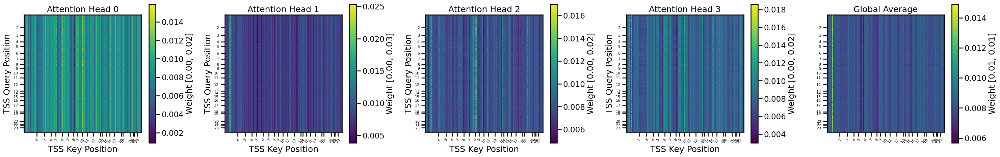

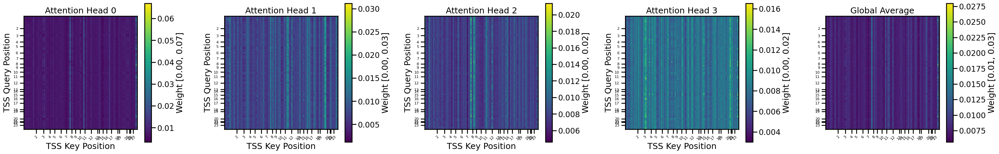

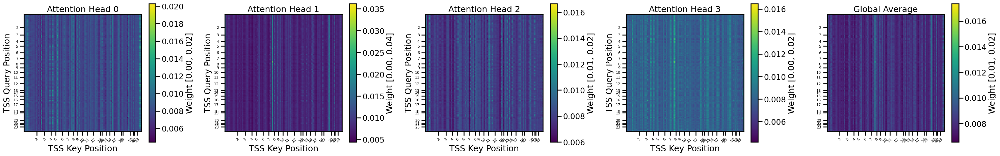

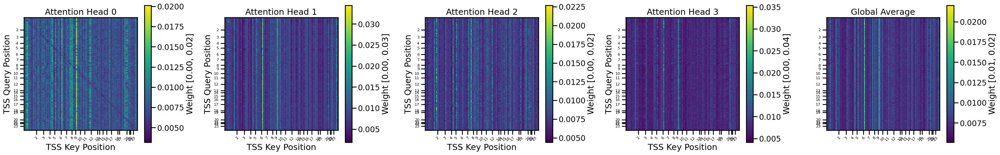

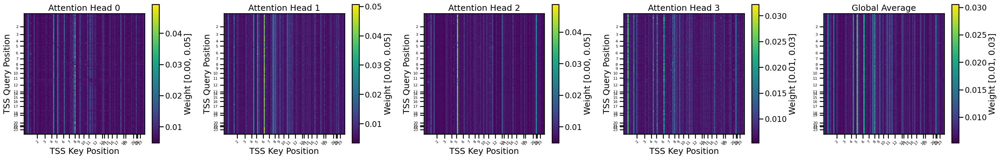

...

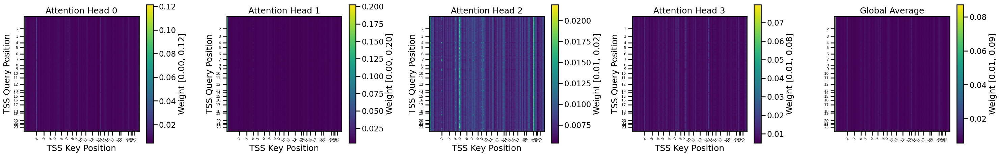

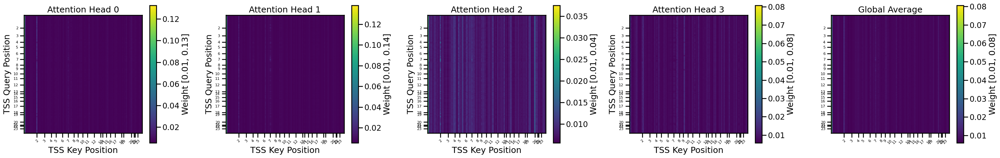

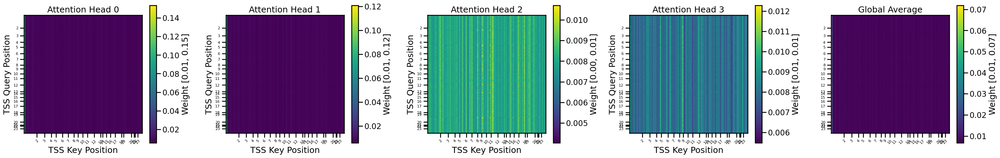

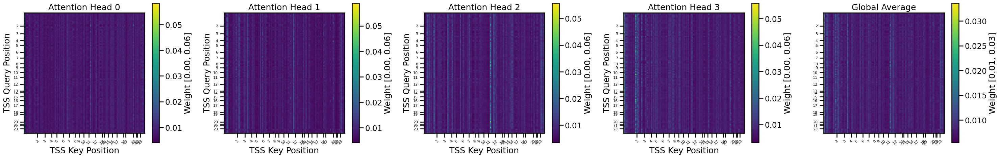

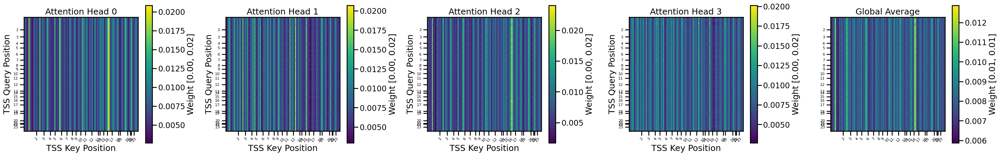

In [18]:
# SMT CLS EMBEDDINGS - 3 versions ###
smt_cls_model_v1 = SharedSelfAttentionCLSModel(input_dim=14760, token_encoder_dim=60, d_model=128,
                                          nhead=4, num_layers=4,
                                          deep_hidden_dims=[512, 256, 128], use_alibi=True, transformer_dropout=0.2,
                                          dropout_rate=0.2, learning_rate=0.00009, weight_decay=0.0001,
                                          batch_size=1024, aug_prob=0.0, epochs=110, num_workers=2, prefetch_factor=4,
                                          cls_init='spatial_learned')

smt_cls_model_v2 = SharedSelfAttentionCLSModel(input_dim=14760, token_encoder_dim=60, d_model=128,
                                          nhead=4, num_layers=4,
                                          deep_hidden_dims=[512, 256, 128], use_alibi=True, transformer_dropout=0.2,
                                          dropout_rate=0.2, learning_rate=0.00009, weight_decay=0.0001,
                                          batch_size=1024, aug_prob=0.0, epochs=110, num_workers=2, prefetch_factor=4,
                                          cls_init='spatial_learned')


# Load weights and prepare models
for i, model in enumerate([smt_cls_model_v1, smt_cls_model_v2], 1):
    model_path = f"/scratch/asr655/neuroinformatics/GeneEx2Conn/models/saved_models/HCP_smtcls_full{i}_spin.pt"
    model.load_state_dict(torch.load(model_path))
    model.eval()
    model.to("cuda")
    model.encoder.eval()

# Get predictions and attention weights for all CLS SMT models across all subnetworks
avg_attn_smtcls_dict_v1 = {}
avg_attn_smtcls_dict_v2 = {}

keys = ['Vis', 'SomMot', 'DorsAttn', 'SalVentAttn', 'Cont', 'Default', 'Limbic', 'Subcortical', 'Cerebellum']

# Collect for CLS model v1
for subnetwork in keys:
    print(f"Collecting attention weights for CLS SMT model v1 on {subnetwork} system data...")
    predictions_v1, targets_v1, avg_attn = smt_cls_model_v1.predict(
        network_dataloaders[subnetwork],
        collect_attn=True,
        #save_attn_path=f'smt_cls_v1_{subnetwork}_avg_attn.npy'
    )
    avg_attn_smtcls_dict_v1[subnetwork] = avg_attn

# Collect for CLS model v2  
for subnetwork in keys:
    print(f"Collecting attention weights for CLS SMT model v2 on {subnetwork} system data...")
    predictions_v2, targets_v2, avg_attn = smt_cls_model_v2.predict(
        network_dataloaders[subnetwork],
        collect_attn=True,
        #save_attn_path=f'smt_cls_v2_{subnetwork}_avg_attn.npy'
    )
    avg_attn_smtcls_dict_v2[subnetwork] = avg_attn

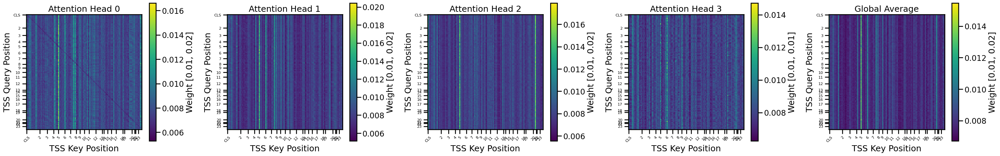

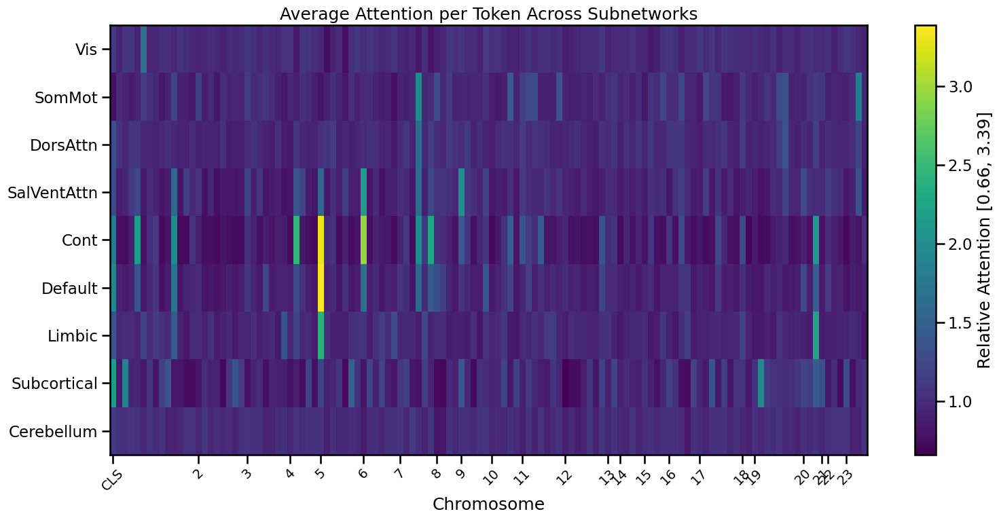

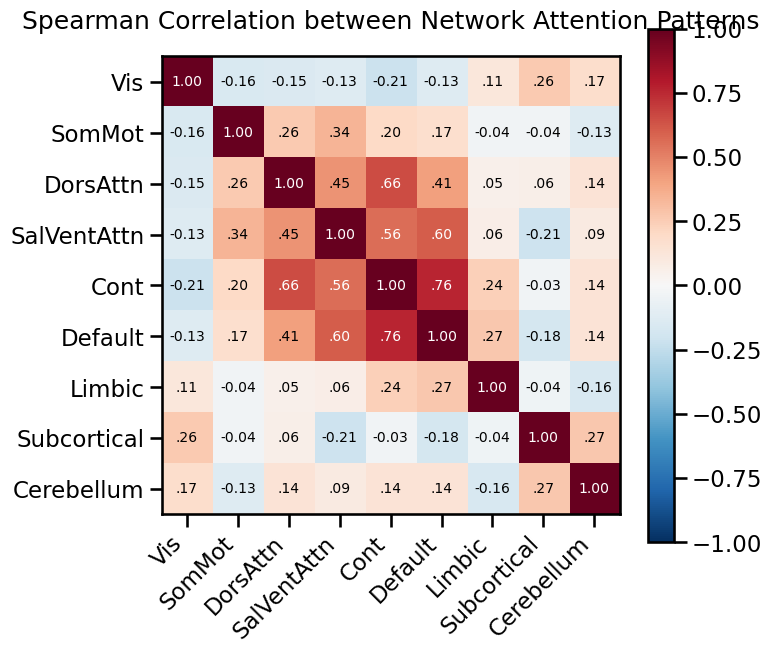

array([[1.12770295, 0.93477416, 1.09671116, ..., 1.03823876, 0.95555127,
        0.93536729],
       [0.78313529, 0.98566586, 0.93357688, ..., 0.9803074 , 1.81162059,
        0.94277906],
       [1.31534076, 1.04616463, 0.95330083, ..., 1.01503992, 1.22200477,
        0.92145145],
       ...,
       [1.37625527, 0.97067708, 0.99011445, ..., 0.98176491, 0.94722033,
        0.81717974],
       [2.15008378, 0.85078424, 1.85686362, ..., 0.7753799 , 0.98550409,
        1.03377962],
       [1.12788248, 1.05515933, 1.03318906, ..., 0.92797065, 0.9360882 ,
        1.05994356]])

In [19]:
plot_global_head_attention(avg_attn_smtcls_dict_v1, use_chrom_labels=True, token_encoder_dim=60, cls_token=True)
plot_subnetwork_token_attention(avg_attn_smtcls_dict_v1, use_chrom_labels=True, token_encoder_dim=60, cls_token=True)

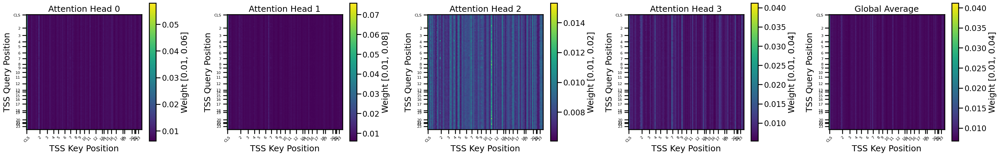

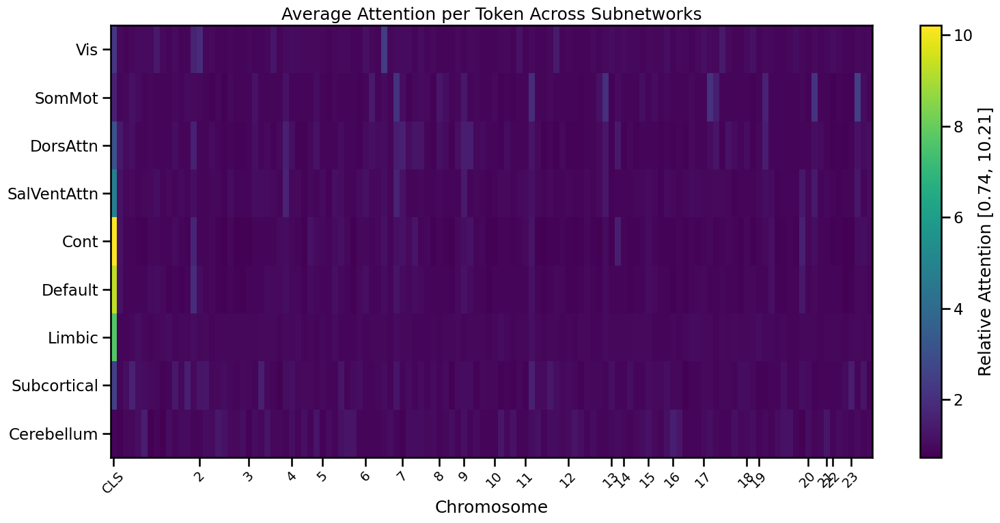

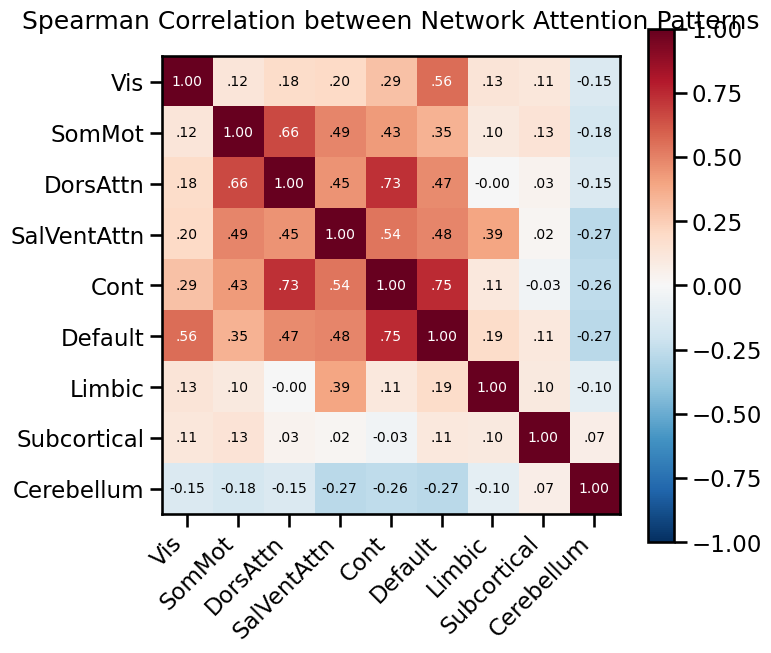

array([[2.22910905, 0.97546113, 0.86325419, ..., 0.98757243, 0.93433499,
        0.98488748],
       [1.55696738, 0.90339595, 0.95584416, ..., 2.529217  , 1.03775477,
        0.90689892],
       [3.11900854, 1.39877641, 1.02128911, ..., 1.19652104, 1.03353131,
        1.09039283],
       ...,
       [7.68025589, 0.89753115, 0.89940113, ..., 0.97716916, 0.93079305,
        0.98636305],
       [2.52590513, 0.85277843, 1.10547757, ..., 0.90940857, 1.22447991,
        0.82892835],
       [0.85070384, 0.79567677, 0.93291354, ..., 0.99923235, 0.89558458,
        0.94993126]])

In [20]:
plot_global_head_attention(avg_attn_smtcls_dict_v2, use_chrom_labels=True, token_encoder_dim=60, cls_token=True)
plot_subnetwork_token_attention(avg_attn_smtcls_dict_v2, use_chrom_labels=True, token_encoder_dim=60, cls_token=True)